# ***YOLOV5 - Object detection:***

CNN-based Object Detectors are primarily applicable for recommendation systems. YOLO (You Only Look Once) models are used for Object detection with high performance. YOLO divides an image into a grid system, and each grid detects objects within itself. They can be used for real-time object detection based on the data streams. They require very few computational resources.

**YOLOV5 Architecture:**

## **Block diagram of YOLOV5**

<img src='https://miro.medium.com/max/1400/1*e17LeKXUsSxdNTlSm_Cz8w.png'>

## **Flow chart of YOLOv5 Architecture**

<img src='https://miro.medium.com/max/1400/1*mAxsoIEeLNM_2TP-n6vTew.png'>


Fullcredit: https://medium.com/analytics-vidhya/object-detection-algorithm-yolo-v5-architecture-89e0a35472ef

# **Steps:**

1. Create Custom data
2. Annotation the custom data --> Makesense.ai
3. Build the prediciton using predtrained model YOLOV5S and YOLOV5M
4. First process object detection coco 80dataset --> Then changed my custom data labels (custom.yaml)
5. Train the custom data
6. Inference the model to predict output
7. Display the output

## **Download YOLO V5**


In [1]:
!git clone https://github.com/ultralytics/yolov5  # clone
%cd yolov5
%pip install -qr requirements.txt  # install

import torch
import utils
display = utils.notebook_init()  # checks

YOLOv5 🚀 v6.1-178-g4870064 torch 1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)


Setup complete ✅ (2 CPUs, 12.7 GB RAM, 38.2/78.2 GB disk)


## **Mount Drive**

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
#unzip the data
!unzip -q /content/drive/MyDrive/Football_analysis/inputdata/train_data.zip -d /content

# **Build YOLOv5s Model**

## **Train**

In [5]:
# Train YOLOv5s on COCO128 for 3 epochs
!python train.py --img 640 --batch 16 --epochs 60 --data custom_data.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=custom_data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=60, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-178-g4870064 torch 1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degrees=0.0, trans

## **Inference of training model**

In [7]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 640 --conf 0.1 --source /content/1.png


detect: weights=['runs/train/exp/weights/best.pt'], source=/content/1.png, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-178-g4870064 torch 1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 213 layers, 7020913 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/1.png: 384x640 8 Team1s, 4 Team2s, 1 Ball, Done. (0.016s)
8 Team1
4 Team2
image 1/1 /content/1.png: 384x640 8 Team1s, 4 Team2s, 1 Ball, Done. (0.016s)
Speed: 0.4ms pre-process, 16.0ms inference, 1.3ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp


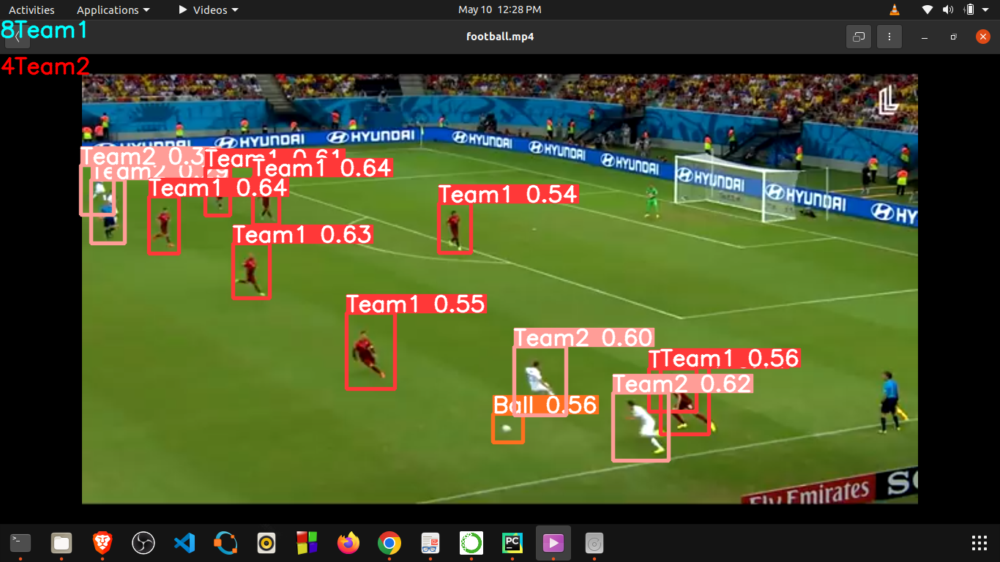

In [8]:
display.Image(filename='runs/detect/exp/1.png', width=600)

In [10]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 640 --conf 0.1 --source /content/f1.png


detect: weights=['runs/train/exp/weights/best.pt'], source=/content/f1.png, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-178-g4870064 torch 1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 213 layers, 7020913 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/f1.png: 384x640 14 Team1s, 12 Team2s, Done. (0.015s)
14 Team1
12 Team2
image 1/1 /content/f1.png: 384x640 14 Team1s, 12 Team2s, Done. (0.015s)
Speed: 0.4ms pre-process, 15.4ms inference, 1.3ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp3


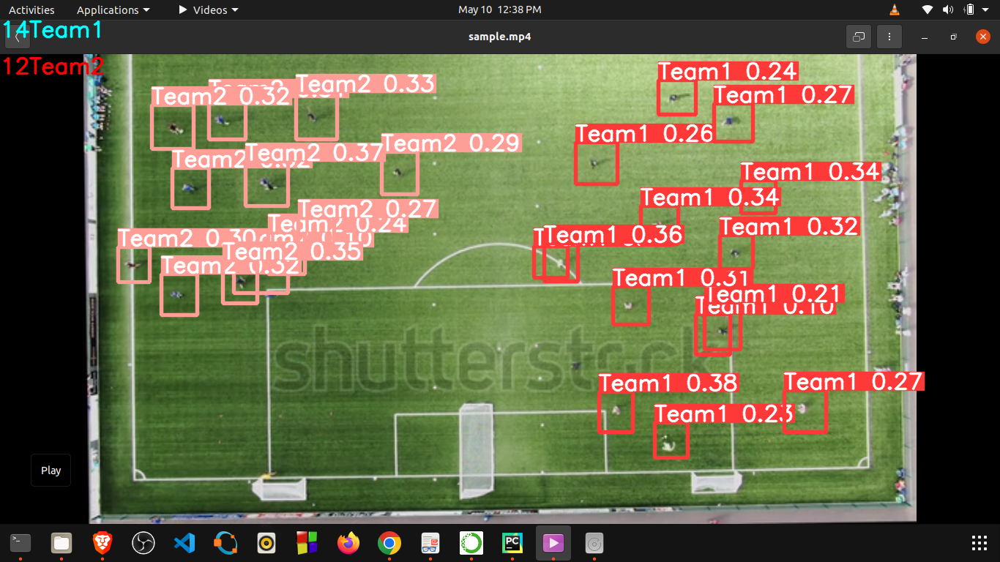

In [11]:
display.Image(filename='runs/detect/exp3/f1.png', width=600)

In [13]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 640 --conf 0.1 --iou 0.1 --source /content/drive/MyDrive/Football_analysis/inputdata/football.mp4



Streaming output truncated to the last 5000 lines.
video 1/1 (6365/7701) /content/drive/MyDrive/Football_analysis/inputdata/football.mp4: 384x640 2 Team1s, 3 Team2s, Done. (0.010s)
2 Team1
3 Team2
video 1/1 (6365/7701) /content/drive/MyDrive/Football_analysis/inputdata/football.mp4: 384x640 2 Team1s, 3 Team2s, Done. (0.010s)
video 1/1 (6366/7701) /content/drive/MyDrive/Football_analysis/inputdata/football.mp4: 384x640 3 Team1s, 4 Team2s, Done. (0.010s)
3 Team1
4 Team2
video 1/1 (6366/7701) /content/drive/MyDrive/Football_analysis/inputdata/football.mp4: 384x640 3 Team1s, 4 Team2s, Done. (0.010s)
video 1/1 (6367/7701) /content/drive/MyDrive/Football_analysis/inputdata/football.mp4: 384x640 2 Team1s, 3 Team2s, Done. (0.010s)
2 Team1
3 Team2
video 1/1 (6367/7701) /content/drive/MyDrive/Football_analysis/inputdata/football.mp4: 384x640 2 Team1s, 3 Team2s, Done. (0.010s)
video 1/1 (6368/7701) /content/drive/MyDrive/Football_analysis/inputdata/football.mp4: 384x640 1 Team1, 3 Team2s, Done. (

In [28]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = "/content/yolov5/runs/detect/exp5/football.mp4"

# Compressed video path
compressed_path = "/content/football_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [23]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 640 --conf 0.1 --iou 0.1 --source /content/drive/MyDrive/Football_analysis/inputdata/sample.mp4


detect: weights=['runs/train/exp/weights/best.pt'], source=/content/drive/MyDrive/Football_analysis/inputdata/sample.mp4, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.1, iou_thres=0.1, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-178-g4870064 torch 1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 213 layers, 7020913 parameters, 0 gradients, 15.8 GFLOPs
video 1/1 (1/1222) /content/drive/MyDrive/Football_analysis/inputdata/sample.mp4: 384x640 4 Team1s, 18 Team2s, Done. (0.015s)
4 Team1
18 Team2
video 1/1 (1/1222) /content/drive/MyDrive/Football_analysis/inputdata/sample.mp4: 384x640 4 Team1s, 18 Team2s, Done. (0.015s)
video 1/1 (2/1222) /content/drive/MyDrive/Football_analysis/input

In [26]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = "/content/yolov5/runs/detect/exp6/sample.mp4"

# Compressed video path
compressed_path = "/content/sample_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

## **Yolov5m Model**

In [29]:
# Train YOLOv5s on COCO128 for 100 epochs
!python train.py --img 640 --batch 32 --epochs 100 --data custom_data.yaml --weights yolov5m.pt --cache

train: weights=yolov5m.pt, cfg=, data=custom_data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=32, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-178-g4870064 torch 1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degrees=0.0, tran

## **Inference_Apply different data**

In [30]:
!python detect.py --weights runs/train/exp2/weights/best.pt --img 640 --conf 0.1   --source /content/11.png


detect: weights=['runs/train/exp2/weights/best.pt'], source=/content/11.png, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-178-g4870064 torch 1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 290 layers, 20865057 parameters, 0 gradients, 48.0 GFLOPs
image 1/1 /content/11.png: 384x640 1 Team1, 1 Team2, 1 Ball, Done. (0.026s)
1 Team1
1 Team2
image 1/1 /content/11.png: 384x640 1 Team1, 1 Team2, 1 Ball, Done. (0.026s)
Speed: 0.5ms pre-process, 25.6ms inference, 1.3ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp7


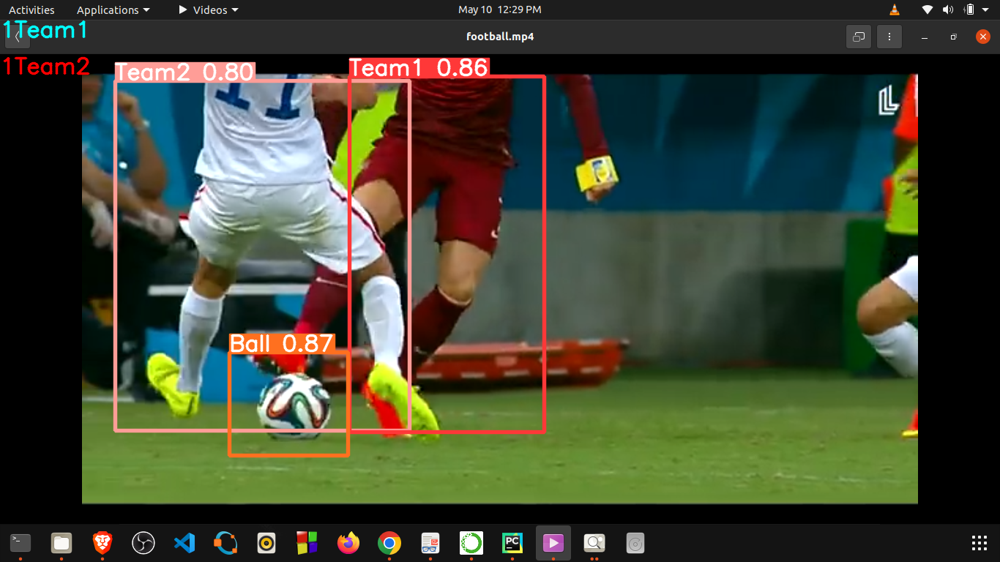

In [31]:
display.Image(filename='runs/detect/exp7/11.png', width=600)

In [32]:
!python detect.py --weights runs/train/exp2/weights/best.pt --img 640 --conf 0.1   --source /content/drive/MyDrive/Football_analysis/inputdata/sample.mp4


detect: weights=['runs/train/exp2/weights/best.pt'], source=/content/drive/MyDrive/Football_analysis/inputdata/sample.mp4, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-178-g4870064 torch 1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 290 layers, 20865057 parameters, 0 gradients, 48.0 GFLOPs
video 1/1 (1/1222) /content/drive/MyDrive/Football_analysis/inputdata/sample.mp4: 384x640 3 Team1s, 20 Team2s, Done. (0.023s)
3 Team1
20 Team2
video 1/1 (1/1222) /content/drive/MyDrive/Football_analysis/inputdata/sample.mp4: 384x640 3 Team1s, 20 Team2s, Done. (0.023s)
video 1/1 (2/1222) /content/drive/MyDrive/Football_analysis/in

In [33]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = "/content/yolov5/runs/detect/exp8/sample.mp4"

# Compressed video path
compressed_path = "/content/sample_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [62]:
!python detect.py --weights runs/train/exp2/weights/best.pt --img 640 --conf 0.1 --iou 0.15   --source /content/drive/MyDrive/Football_analysis/inputdata/football.mp4


Streaming output truncated to the last 5000 lines.
video 1/1 (6202/7701) /content/drive/MyDrive/Football_analysis/inputdata/football.mp4: 384x640 Done. (0.041s)
video 1/1 (6203/7701) /content/drive/MyDrive/Football_analysis/inputdata/football.mp4: 384x640 Done. (0.040s)
video 1/1 (6203/7701) /content/drive/MyDrive/Football_analysis/inputdata/football.mp4: 384x640 Done. (0.040s)
video 1/1 (6204/7701) /content/drive/MyDrive/Football_analysis/inputdata/football.mp4: 384x640 Done. (0.040s)
video 1/1 (6204/7701) /content/drive/MyDrive/Football_analysis/inputdata/football.mp4: 384x640 Done. (0.040s)
video 1/1 (6205/7701) /content/drive/MyDrive/Football_analysis/inputdata/football.mp4: 384x640 Done. (0.041s)
video 1/1 (6205/7701) /content/drive/MyDrive/Football_analysis/inputdata/football.mp4: 384x640 Done. (0.041s)
video 1/1 (6206/7701) /content/drive/MyDrive/Football_analysis/inputdata/football.mp4: 384x640 Done. (0.041s)
video 1/1 (6206/7701) /content/drive/MyDrive/Football_analysis/inputd

In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = "/content/yolov5/runs/detect/exp28/football.mp4"

# Compressed video path
compressed_path = "/content/football_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

### Reference: 
1. https://github.com/ultralytics/yolov5